<a href="https://colab.research.google.com/github/Khizer-Data/darknet2020-traffic-classification/blob/main/Notebook_darknet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier

In [ ]:
df = pd.read_csv('Darknet.csv')
df.head()

,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Total Fwd Packet,Total Bwd packets,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label,Label.1
0,10.152.152.11-216.58.220.99-57158-443-6,10.152.152.11,57158,216.58.220.99,443,6,24/07/2015 04:09:48 PM,229,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
1,10.152.152.11-216.58.220.99-57159-443-6,10.152.152.11,57159,216.58.220.99,443,6,24/07/2015 04:09:48 PM,407,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
2,10.152.152.11-216.58.220.99-57160-443-6,10.152.152.11,57160,216.58.220.99,443,6,24/07/2015 04:09:48 PM,431,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
3,10.152.152.11-74.125.136.120-49134-443-6,10.152.152.11,49134,74.125.136.120,443,6,24/07/2015 04:09:48 PM,359,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
4,10.152.152.11-173.194.65.127-34697-19305-6,10.152.152.11,34697,173.194.65.127,19305,6,24/07/2015 04:09:45 PM,10778451,591,400,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,Non-Tor,AUDIO-STREAMING


In [ ]:
df.shape

(158616, 85)

In [ ]:
print(df['Label'].unique())
print(df['Label.1'].unique())

['Non-Tor' 'NonVPN' 'Tor' 'VPN']
['AUDIO-STREAMING' 'Chat' 'Audio-Streaming' 'Browsing' 'Email'
 'File-Transfer' 'File-transfer' 'P2P' 'Video-Streaming' 'Video-streaming'
 'VOIP']


In [ ]:
pd.set_option('display.max_rows', None)
print(pd.Series(df.isnull().sum()))

Flow ID                        0
Src IP                         0
Src Port                       0
Dst IP                         0
Dst Port                       0
Protocol                       0
Timestamp                      0
Flow Duration                  0
Total Fwd Packet               0
Total Bwd packets              0
Total Length of Fwd Packet     0
Total Length of Bwd Packet     0
Fwd Packet Length Max          0
Fwd Packet Length Min          0
Fwd Packet Length Mean         0
Fwd Packet Length Std          0
Bwd Packet Length Max          0
Bwd Packet Length Min          0
Bwd Packet Length Mean         0
Bwd Packet Length Std          0
Flow Bytes/s                  48
Flow Packets/s                 0
Flow IAT Mean                  0
Flow IAT Std                   0
Flow IAT Max                   0
Flow IAT Min                   0
Fwd IAT Total                  0
Fwd IAT Mean                   0
Fwd IAT Std                    0
Fwd IAT Max                    0
Fwd IAT Mi

In [ ]:
df['Flow Bytes/s'].fillna(df['Flow Bytes/s'].mean(), inplace=True)
df['Flow Packets/s'].fillna(df['Flow Packets/s'].mean(), inplace=True)

<ipython-input-216-4ed57b9fe73c>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Flow Bytes/s'].fillna(df['Flow Bytes/s'].mean(), inplace=True)
<ipython-input-216-4ed57b9fe73c>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inpl

In [ ]:
pd.set_option('display.max_rows', None)
print(pd.Series(df.isnull().sum()))

Flow ID                       0
Src IP                        0
Src Port                      0
Dst IP                        0
Dst Port                      0
Protocol                      0
Timestamp                     0
Flow Duration                 0
Total Fwd Packet              0
Total Bwd packets             0
Total Length of Fwd Packet    0
Total Length of Bwd Packet    0
Fwd Packet Length Max         0
Fwd Packet Length Min         0
Fwd Packet Length Mean        0
Fwd Packet Length Std         0
Bwd Packet Length Max         0
Bwd Packet Length Min         0
Bwd Packet Length Mean        0
Bwd Packet Length Std         0
Flow Bytes/s                  0
Flow Packets/s                0
Flow IAT Mean                 0
Flow IAT Std                  0
Flow IAT Max                  0
Flow IAT Min                  0
Fwd IAT Total                 0
Fwd IAT Mean                  0
Fwd IAT Std                   0
Fwd IAT Max                   0
Fwd IAT Min                   0
Bwd IAT 

In [ ]:
df['Traffic_Category'] = df['Label.1']
df['Traffic_Category']

,Traffic_Category
0,AUDIO-STREAMING
1,AUDIO-STREAMING
2,AUDIO-STREAMING
3,AUDIO-STREAMING
4,AUDIO-STREAMING
5,AUDIO-STREAMING
6,AUDIO-STREAMING
7,AUDIO-STREAMING
8,AUDIO-STREAMING
9,AUDIO-STREAMING


In [ ]:
df.drop(['Label.1'], axis=1, inplace=True)
df.head()

,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Total Fwd Packet,Total Bwd packets,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label,Traffic_Category
0,10.152.152.11-216.58.220.99-57158-443-6,10.152.152.11,57158,216.58.220.99,443,6,24/07/2015 04:09:48 PM,229,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
1,10.152.152.11-216.58.220.99-57159-443-6,10.152.152.11,57159,216.58.220.99,443,6,24/07/2015 04:09:48 PM,407,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
2,10.152.152.11-216.58.220.99-57160-443-6,10.152.152.11,57160,216.58.220.99,443,6,24/07/2015 04:09:48 PM,431,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
3,10.152.152.11-74.125.136.120-49134-443-6,10.152.152.11,49134,74.125.136.120,443,6,24/07/2015 04:09:48 PM,359,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
4,10.152.152.11-173.194.65.127-34697-19305-6,10.152.152.11,34697,173.194.65.127,19305,6,24/07/2015 04:09:45 PM,10778451,591,400,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,Non-Tor,AUDIO-STREAMING


In [ ]:
df.rename(columns={'Label': 'Class'}, inplace=True)
df.head()

,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Total Fwd Packet,Total Bwd packets,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Class,Traffic_Category
0,10.152.152.11-216.58.220.99-57158-443-6,10.152.152.11,57158,216.58.220.99,443,6,24/07/2015 04:09:48 PM,229,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
1,10.152.152.11-216.58.220.99-57159-443-6,10.152.152.11,57159,216.58.220.99,443,6,24/07/2015 04:09:48 PM,407,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
2,10.152.152.11-216.58.220.99-57160-443-6,10.152.152.11,57160,216.58.220.99,443,6,24/07/2015 04:09:48 PM,431,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
3,10.152.152.11-74.125.136.120-49134-443-6,10.152.152.11,49134,74.125.136.120,443,6,24/07/2015 04:09:48 PM,359,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,Non-Tor,AUDIO-STREAMING
4,10.152.152.11-173.194.65.127-34697-19305-6,10.152.152.11,34697,173.194.65.127,19305,6,24/07/2015 04:09:45 PM,10778451,591,400,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,Non-Tor,AUDIO-STREAMING


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158616 entries, 0 to 158615
Data columns (total 85 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Flow ID                     158616 non-null  object 
 1   Src IP                      158616 non-null  object 
 2   Src Port                    158616 non-null  int64  
 3   Dst IP                      158616 non-null  object 
 4   Dst Port                    158616 non-null  int64  
 5   Protocol                    158616 non-null  int64  
 6   Timestamp                   158616 non-null  object 
 7   Flow Duration               158616 non-null  int64  
 8   Total Fwd Packet            158616 non-null  int64  
 9   Total Bwd packets           158616 non-null  int64  
 10  Total Length of Fwd Packet  158616 non-null  int64  
 11  Total Length of Bwd Packet  158616 non-null  int64  
 12  Fwd Packet Length Max       158616 non-null  int64  
 13  Fwd Packet Len

In [ ]:

label_encoder = LabelEncoder()

df['Class'] = label_encoder.fit_transform(df['Class'])

df['Traffic_Category'] = label_encoder.fit_transform(df['Traffic_Category'])

df.head()

,Flow ID,Src IP,Src Port,Dst IP,Dst Port,Protocol,Timestamp,Flow Duration,Total Fwd Packet,Total Bwd packets,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Class,Traffic_Category
0,10.152.152.11-216.58.220.99-57158-443-6,10.152.152.11,57158,216.58.220.99,443,6,24/07/2015 04:09:48 PM,229,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
1,10.152.152.11-216.58.220.99-57159-443-6,10.152.152.11,57159,216.58.220.99,443,6,24/07/2015 04:09:48 PM,407,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
2,10.152.152.11-216.58.220.99-57160-443-6,10.152.152.11,57160,216.58.220.99,443,6,24/07/2015 04:09:48 PM,431,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
3,10.152.152.11-74.125.136.120-49134-443-6,10.152.152.11,49134,74.125.136.120,443,6,24/07/2015 04:09:48 PM,359,1,1,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
4,10.152.152.11-173.194.65.127-34697-19305-6,10.152.152.11,34697,173.194.65.127,19305,6,24/07/2015 04:09:45 PM,10778451,591,400,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0,0


In [ ]:
print(df['Class'].unique())
print(df['Traffic_Category'].unique())

[0 1 2 3]
[ 0  3  1  2  4  5  6  7  9 10  8]


In [ ]:
df.drop(['Timestamp','Flow ID'], axis=1, inplace=True)

In [ ]:
df.head()

,Src IP,Src Port,Dst IP,Dst Port,Protocol,Flow Duration,Total Fwd Packet,Total Bwd packets,Total Length of Fwd Packet,Total Length of Bwd Packet,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Class,Traffic_Category
0,10.152.152.11,57158,216.58.220.99,443,6,229,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
1,10.152.152.11,57159,216.58.220.99,443,6,407,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
2,10.152.152.11,57160,216.58.220.99,443,6,431,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
3,10.152.152.11,49134,74.125.136.120,443,6,359,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
4,10.152.152.11,34697,173.194.65.127,19305,6,10778451,591,400,64530,6659,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0,0


In [ ]:

def ip_to_numerical(ip_address):
    try:
        return hash(ip_address)
    except:
        return 0

df['Src IP'] = df['Src IP'].apply(ip_to_numerical)
df['Dst IP'] = df['Dst IP'].apply(ip_to_numerical)

df.head()

,Src IP,Src Port,Dst IP,Dst Port,Protocol,Flow Duration,Total Fwd Packet,Total Bwd packets,Total Length of Fwd Packet,Total Length of Bwd Packet,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Class,Traffic_Category
0,-437142193533760600,57158,-6401269050953156419,443,6,229,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
1,-437142193533760600,57159,-6401269050953156419,443,6,407,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
2,-437142193533760600,57160,-6401269050953156419,443,6,431,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
3,-437142193533760600,49134,7550634163130440910,443,6,359,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
4,-437142193533760600,34697,5903040549196545634,19305,6,10778451,591,400,64530,6659,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0,0


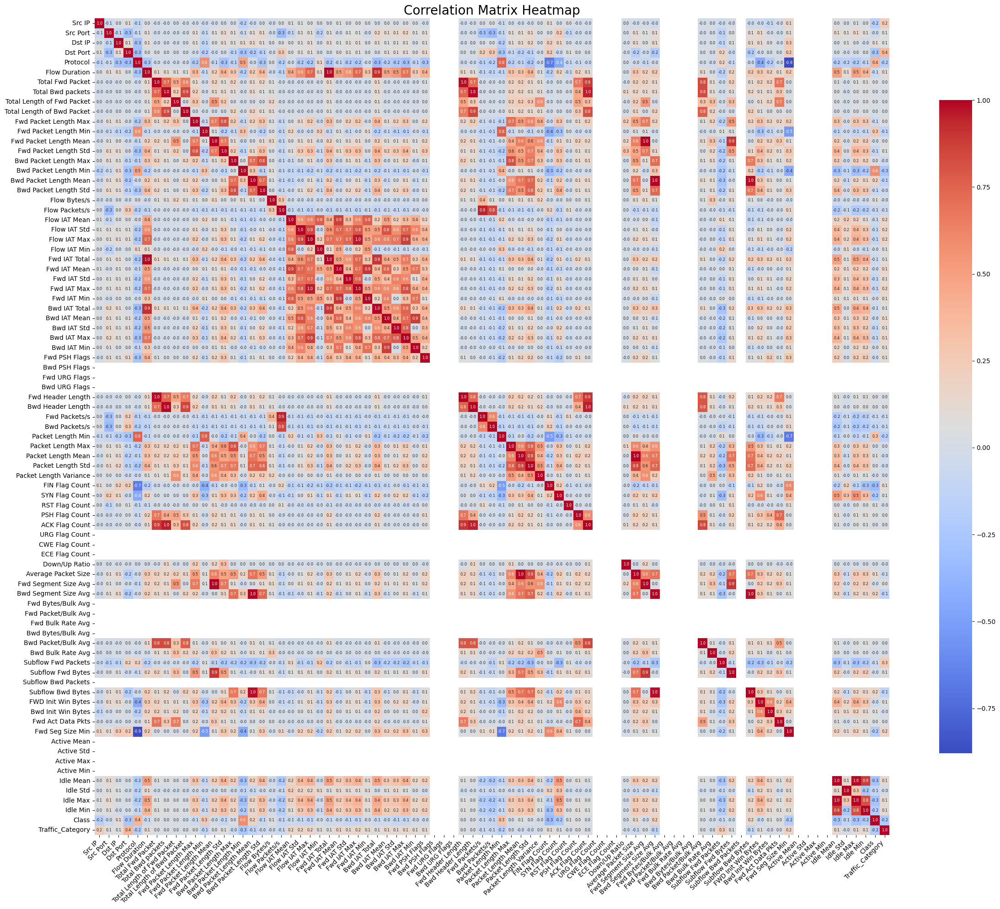

In [ ]:


plt.figure(figsize=(24, 20))


correlation_matrix = df.corr()


sns.heatmap(
    correlation_matrix,
    annot=True,
    annot_kws={"size": 6},
    cmap='coolwarm',
    fmt=".1f",
    xticklabels=1,
    yticklabels=1,
    cbar_kws={"shrink": 0.8}
)


plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)


plt.title('Correlation Matrix Heatmap', fontsize=20)


plt.tight_layout()
plt.show()


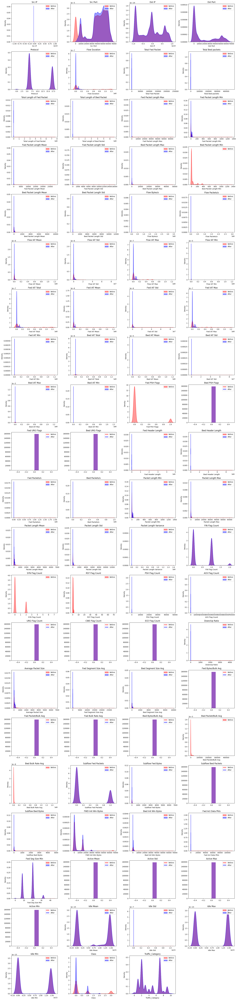

In [ ]:
def remove_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df_filtered = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df_filtered


numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns


num_cols = 4
num_rows = (len(numerical_columns) + num_cols - 1) // num_cols

plt.figure(figsize=(20, num_rows * 4))

for i, column in enumerate(numerical_columns, 1):

    df_filtered = remove_outliers_iqr(df, column)


    plt.subplot(num_rows, num_cols, i)
    if df[column].nunique() > 1:
        sns.kdeplot(df[column], label='Before', color='red', fill=True, alpha=0.4, warn_singular=False)
        sns.kdeplot(df_filtered[column], label='After', color='blue', fill=True, alpha=0.4, warn_singular=False)
    else:
        plt.hist(df[column], bins=10, color='red', alpha=0.4, label='Before')
        plt.hist(df_filtered[column], bins=10, color='blue', alpha=0.4, label='After')

    plt.title(column)
    plt.legend()

plt.tight_layout()
plt.show()


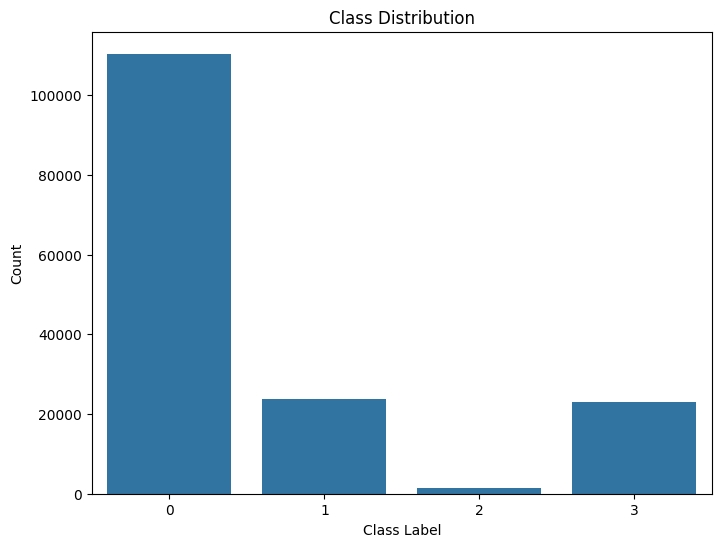

In [ ]:

plt.figure(figsize=(8, 6))
sns.countplot(x='Class', data=df)
plt.title('Class Distribution')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.show()

In [ ]:
df.head()

,Src IP,Src Port,Dst IP,Dst Port,Protocol,Flow Duration,Total Fwd Packet,Total Bwd packets,Total Length of Fwd Packet,Total Length of Bwd Packet,...,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Class,Traffic_Category
0,-437142193533760600,57158,-6401269050953156419,443,6,229,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
1,-437142193533760600,57159,-6401269050953156419,443,6,407,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
2,-437142193533760600,57160,-6401269050953156419,443,6,431,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
3,-437142193533760600,49134,7550634163130440910,443,6,359,1,1,0,0,...,0,0,0,0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0,0
4,-437142193533760600,34697,5903040549196545634,19305,6,10778451,591,400,64530,6659,...,0,0,0,0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0,0


In [ ]:
print("Number of +inf values:", np.isinf(df).sum().sum())
print("Number of -inf values:", np.isneginf(df).sum().sum())

Number of +inf values: 100
Number of -inf values: 0


In [ ]:
df.replace(np.inf, np.nan, inplace=True)

In [ ]:
imputer = SimpleImputer(strategy='mean')
df= imputer.fit_transform(df)


In [ ]:
print("Number of NaN values:", np.isnan(df).sum().sum())
print("Number of +inf values:", np.isinf(df).sum().sum())
print("Number of -inf values:", np.isneginf(df).sum().sum())

Number of NaN values: 0
Number of +inf values: 0
Number of -inf values: 0


In [ ]:
df = pd.DataFrame(df)

In [ ]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,73,74,75,76,77,78,79,80,81,82
0,-4.371422e+17,57158.0,-6.401269e+18,443.0,6.0,229.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
1,-4.371422e+17,57159.0,-6.401269e+18,443.0,6.0,407.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
2,-4.371422e+17,57160.0,-6.401269e+18,443.0,6.0,431.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
3,-4.371422e+17,49134.0,7.550634e+18,443.0,6.0,359.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
4,-4.371422e+17,34697.0,5.903041e+18,19305.0,6.0,10778451.0,591.0,400.0,64530.0,6659.0,...,0.0,0.0,0.0,0.0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0.0,0.0


In [ ]:

column_mapping = {
    0: "src_ip",
    1: "src_port",
    2: "dst_ip",
    3: "dst_port",
    4: "protocol",
    5: "flow_duration",
    6: "total_fwd_packet",
    7: "total_bwd_packets",
    8: "total_length_fwd_packet",
    9: "total_length_bwd_packet",
    10: "fwd_packet_length_max",
    11: "fwd_packet_length_min",
    12: "fwd_packet_length_mean",
    13: "fwd_packet_length_std",
    14: "bwd_packet_length_max",
    15: "bwd_packet_length_min",
    16: "bwd_packet_length_mean",
    17: "bwd_packet_length_std",
    18: "flow_bytes_s",
    19: "flow_packets_s",
    20: "flow_iat_mean",
    21: "flow_iat_std",
    22: "flow_iat_max",
    23: "flow_iat_min",
    24: "fwd_iat_total",
    25: "fwd_iat_mean",
    26: "fwd_iat_std",
    27: "fwd_iat_max",
    28: "fwd_iat_min",
    29: "bwd_iat_total",
    30: "bwd_iat_mean",
    31: "bwd_iat_std",
    32: "bwd_iat_max",
    33: "bwd_iat_min",
    34: "fwd_psh_flags",
    35: "bwd_psh_flags",
    36: "fwd_urg_flags",
    37: "bwd_urg_flags",
    38: "fwd_header_length",
    39: "bwd_header_length",
    40: "fwd_packets_s",
    41: "bwd_packets_s",
    42: "packet_length_min",
    43: "packet_length_max",
    44: "packet_length_mean",
    45: "packet_length_std",
    46: "packet_length_variance",
    47: "fin_flag_count",
    48: "syn_flag_count",
    49: "rst_flag_count",
    50: "psh_flag_count",
    51: "ack_flag_count",
    52: "urg_flag_count",
    53: "cwe_flag_count",
    54: "ece_flag_count",
    55: "down_up_ratio",
    56: "average_packet_size",
    57: "fwd_segment_size_avg",
    58: "bwd_segment_size_avg",
    59: "fwd_bytes_bulk_avg",
    60: "fwd_packet_bulk_avg",
    61: "fwd_bulk_rate_avg",
    62: "bwd_bytes_bulk_avg",
    63: "bwd_packet_bulk_avg",
    64: "bwd_bulk_rate_avg",
    65: "subflow_fwd_packets",
    66: "subflow_fwd_bytes",
    67: "subflow_bwd_packets",
    68: "subflow_bwd_bytes",
    69: "fwd_init_win_bytes",
    70: "bwd_init_win_bytes",
    71: "fwd_act_data_pkts",
    72: "fwd_seg_size_min",
    73: "active_mean",
    74: "active_std",
    75: "active_max",
    76: "active_min",
    77: "idle_mean",
    78: "idle_std",
    79: "idle_max",
    80: "idle_min",
    81: "class",
    82: "traffic_category"
}

df.columns = [column_mapping[i] for i in range(df.shape[1])]
s
print(df.head())


         src_ip  src_port        dst_ip  dst_port  protocol  flow_duration  \
0 -4.371422e+17   57158.0 -6.401269e+18     443.0       6.0          229.0   
1 -4.371422e+17   57159.0 -6.401269e+18     443.0       6.0          407.0   
2 -4.371422e+17   57160.0 -6.401269e+18     443.0       6.0          431.0   
3 -4.371422e+17   49134.0  7.550634e+18     443.0       6.0          359.0   
4 -4.371422e+17   34697.0  5.903041e+18   19305.0       6.0     10778451.0   

   total_fwd_packet  total_bwd_packets  total_length_fwd_packet  \
0               1.0                1.0                      0.0   
1               1.0                1.0                      0.0   
2               1.0                1.0                      0.0   
3               1.0                1.0                      0.0   
4             591.0              400.0                  64530.0   

   total_length_bwd_packet  ...  active_mean  active_std  active_max  \
0                      0.0  ...          0.0         0.0

In [ ]:
df.head()

,src_ip,src_port,dst_ip,dst_port,protocol,flow_duration,total_fwd_packet,total_bwd_packets,total_length_fwd_packet,total_length_bwd_packet,...,active_mean,active_std,active_max,active_min,idle_mean,idle_std,idle_max,idle_min,class,traffic_category
0,-4.371422e+17,57158.0,-6.401269e+18,443.0,6.0,229.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
1,-4.371422e+17,57159.0,-6.401269e+18,443.0,6.0,407.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
2,-4.371422e+17,57160.0,-6.401269e+18,443.0,6.0,431.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
3,-4.371422e+17,49134.0,7.550634e+18,443.0,6.0,359.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
4,-4.371422e+17,34697.0,5.903041e+18,19305.0,6.0,10778451.0,591.0,400.0,64530.0,6659.0,...,0.0,0.0,0.0,0.0,1.437765e+15,3.117718e+06,1.437765e+15,1.437765e+15,0.0,0.0


In [ ]:

features_to_scale = df.columns.difference(['class'])


scaler = StandardScaler()


df[features_to_scale] = scaler.fit_transform(df[features_to_scale])

df[features_to_scale] = df[features_to_scale] - df[features_to_scale].min() + 1e-6

df.head()


,src_ip,src_port,dst_ip,dst_port,protocol,flow_duration,total_fwd_packet,total_bwd_packets,total_length_fwd_packet,total_length_bwd_packet,...,active_mean,active_std,active_max,active_min,idle_mean,idle_std,idle_max,idle_min,class,traffic_category
0,2.452872,2.968207,0.497311,0.020034,1.111432,0.000007,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
1,2.452872,2.968259,0.497311,0.020034,1.111432,0.000012,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
2,2.452872,2.968311,0.497311,0.020034,1.111432,0.000012,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
3,2.452872,2.551522,2.956973,0.020034,1.111432,0.000010,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
4,2.452872,1.801811,2.666509,0.873008,1.111432,0.283666,0.262472,0.123823,0.021011,0.001545,...,0.000001,0.000001,0.000001,0.000001,2.038680,0.000001,1.983461,2.012140,0.0,0.000001


In [ ]:
df.head()

,src_ip,src_port,dst_ip,dst_port,protocol,flow_duration,total_fwd_packet,total_bwd_packets,total_length_fwd_packet,total_length_bwd_packet,...,active_mean,active_std,active_max,active_min,idle_mean,idle_std,idle_max,idle_min,class,traffic_category
0,2.452872,2.968207,0.497311,0.020034,1.111432,0.000007,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
1,2.452872,2.968259,0.497311,0.020034,1.111432,0.000012,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
2,2.452872,2.968311,0.497311,0.020034,1.111432,0.000012,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
3,2.452872,2.551522,2.956973,0.020034,1.111432,0.000010,0.000001,0.000311,0.000001,0.000001,...,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,0.0,0.000001
4,2.452872,1.801811,2.666509,0.873008,1.111432,0.283666,0.262472,0.123823,0.021011,0.001545,...,0.000001,0.000001,0.000001,0.000001,2.038680,0.000001,1.983461,2.012140,0.0,0.000001


In [ ]:
from imblearn.over_sampling import SMOTE

X = df.drop('class', axis=1)
y = df['class']


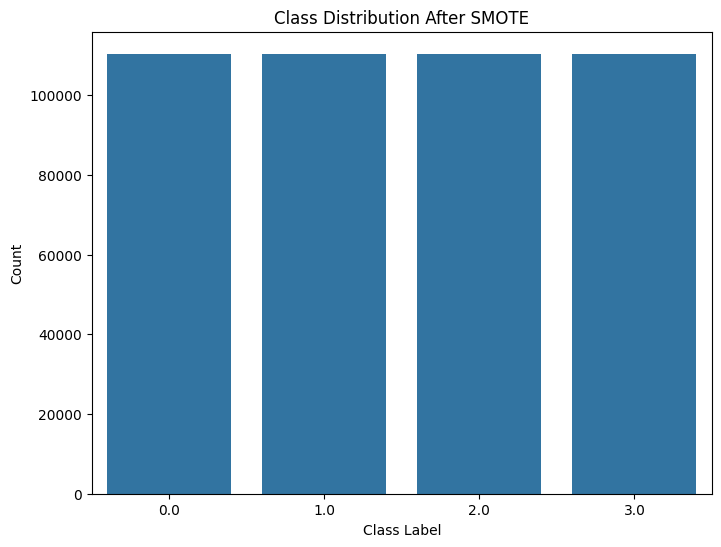

In [ ]:
smote = SMOTE(random_state=42)

X_resampled, y_resampled = smote.fit_resample(X, y)


df_resampled = pd.DataFrame(X_resampled, columns=X.columns)
df_resampled['Class'] = y_resampled

plt.figure(figsize=(8, 6))
sns.countplot(x='Class', data=df_resampled)
plt.title('Class Distribution After SMOTE')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.show()

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

In [ ]:

pca = PCA(n_components=2)

pca.fit(X_train)

X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

print("Explained variance ratio:", pca.explained_variance_ratio_)

Explained variance ratio: [0.50885972 0.14536081]


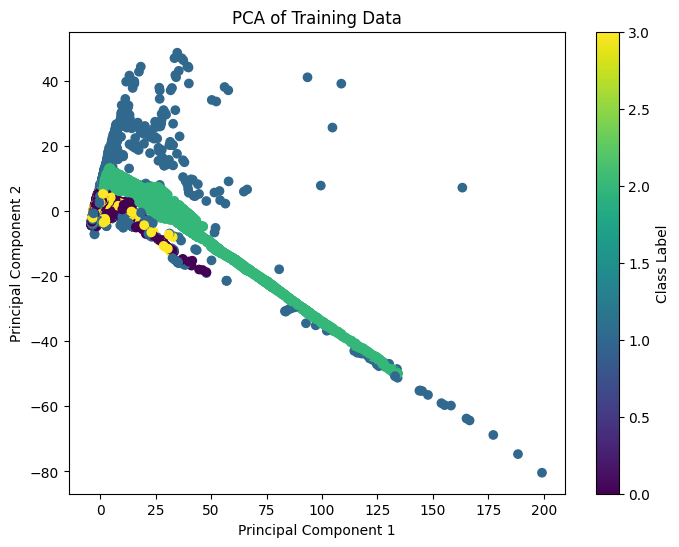

In [ ]:

plt.figure(figsize=(8, 6))
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=y_train, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Training Data')
plt.colorbar(label='Class Label')
plt.show()

Accuracy: 0.5765443556601851
              precision    recall  f1-score   support

         0.0       0.52      0.36      0.42     22057
         1.0       0.41      0.77      0.54     22223
         2.0       0.87      0.83      0.85     22039
         3.0       0.71      0.35      0.47     22035

    accuracy                           0.58     88354
   macro avg       0.63      0.58      0.57     88354
weighted avg       0.63      0.58      0.57     88354



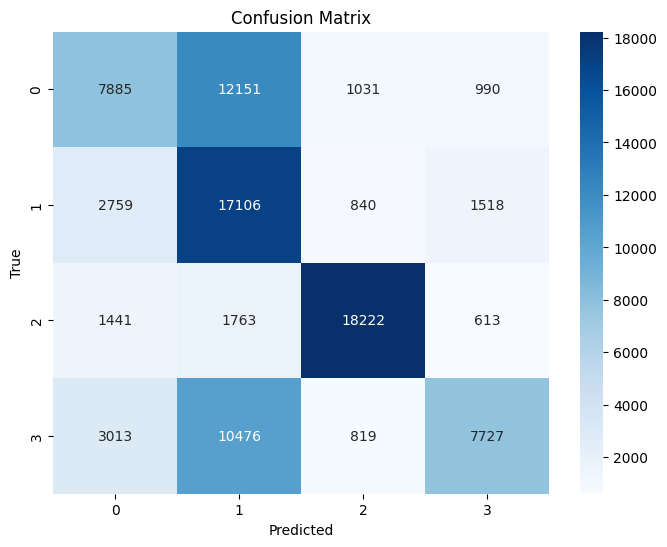

In [ ]:

logreg_model = LogisticRegression(max_iter=1000)
logreg_model.fit(X_train_pca, y_train)


y_pred = logreg_model.predict(X_test_pca)

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

print(classification_report(y_test, y_pred))



cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

Random Forest Accuracy: 0.9005817506847454
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.87     22057
         1.0       0.90      0.86      0.88     22223
         2.0       0.96      0.96      0.96     22039
         3.0       0.91      0.87      0.89     22035

    accuracy                           0.90     88354
   macro avg       0.90      0.90      0.90     88354
weighted avg       0.90      0.90      0.90     88354



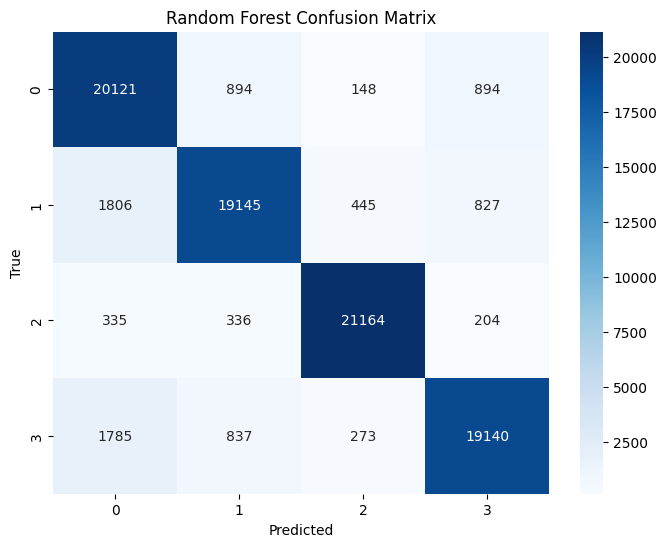

In [ ]:

rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train_pca, y_train)


y_pred_rf = rf_model.predict(X_test_pca)


accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f"Random Forest Accuracy: {accuracy_rf}")

print(classification_report(y_test, y_pred_rf))


cm_rf = confusion_matrix(y_test, y_pred_rf)
plt.figure(figsize=(8, 6))
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Random Forest Confusion Matrix')
plt.show()

XGBoost Accuracy: 0.8200873757837789
              precision    recall  f1-score   support

         0.0       0.73      0.82      0.77     22057
         1.0       0.81      0.77      0.79     22223
         2.0       0.93      0.94      0.93     22039
         3.0       0.82      0.75      0.78     22035

    accuracy                           0.82     88354
   macro avg       0.82      0.82      0.82     88354
weighted avg       0.82      0.82      0.82     88354



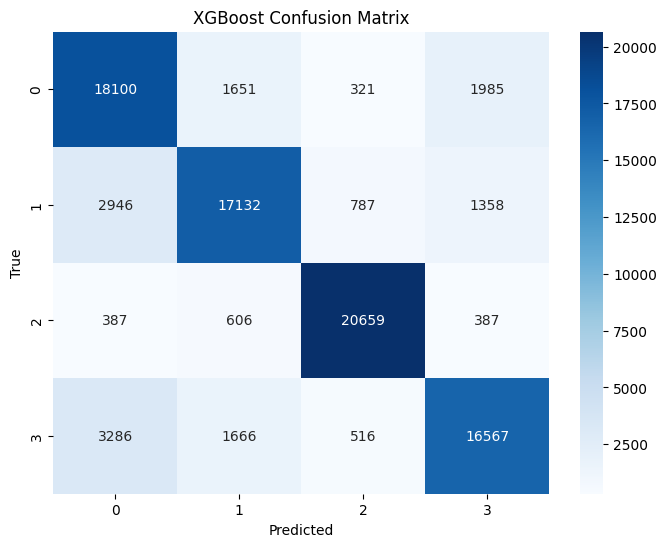

In [ ]:


xgb_model = xgb.XGBClassifier(random_state=42)
xgb_model.fit(X_train_pca, y_train)


y_pred_xgb = xgb_model.predict(X_test_pca)

accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
print(f"XGBoost Accuracy: {accuracy_xgb}")

print(classification_report(y_test, y_pred_xgb))

cm_xgb = confusion_matrix(y_test, y_pred_xgb)
plt.figure(figsize=(8, 6))
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('XGBoost Confusion Matrix')
plt.show()

In [ ]:
model = keras.Sequential([
    keras.layers.Dense(64, activation='relu', input_shape=(X_train_pca.shape[1],)),
    keras.layers.Dense(32, activation='relu'),
    keras.layers.Dense(len(np.unique(y_train)), activation='softmax') # Output layer with softmax for multi-class
])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',  # Use sparse categorical crossentropy for integer labels
              metrics=['accuracy'])

In [ ]:
model.fit(X_train_pca, y_train, epochs=10, batch_size=32, validation_split=0.2)

Epoch 1/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.5851 - loss: 0.9479 - val_accuracy: 0.6389 - val_loss: 0.8531
Epoch 2/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 36s 2ms/step - accuracy: 0.6334 - loss: 0.8336 - val_accuracy: 0.6449 - val_loss: 0.8002
Epoch 3/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.6454 - loss: 0.7995 - val_accuracy: 0.6736 - val_loss: 0.7686
Epoch 4/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.6689 - loss: 0.7644 - val_accuracy: 0.6853 - val_loss: 0.7512
Epoch 5/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.6862 - loss: 0.7452 - val_accuracy: 0.6972 - val_loss: 0.7275
Epoch 6/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.6956 - loss: 0.7354 - val_accuracy: 0.7026 - val_loss: 0.7166
Epoch 7/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.7009 - loss: 0.7258 - val_accuracy: 0.7167 - val_loss: 0.7085
Epoch 8/10
8836/8836 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.7052 - loss: 0

In [ ]:
loss, accuracy = model.evaluate(X_test_pca, y_test)
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")

2762/2762 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.7164 - loss: 0.6968
Test Loss: 0.6958526372909546
Test Accuracy: 0.7165946364402771


In [ ]:
y_pred_prob = model.predict(X_test_pca)
y_pred = np.argmax(y_pred_prob, axis=1) # Get predicted class labels

2762/2762 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step


In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.62      0.75      0.68     22057
         1.0       0.64      0.65      0.65     22223
         2.0       0.92      0.88      0.90     22039
         3.0       0.71      0.58      0.64     22035

    accuracy                           0.72     88354
   macro avg       0.72      0.72      0.72     88354
weighted avg       0.72      0.72      0.72     88354



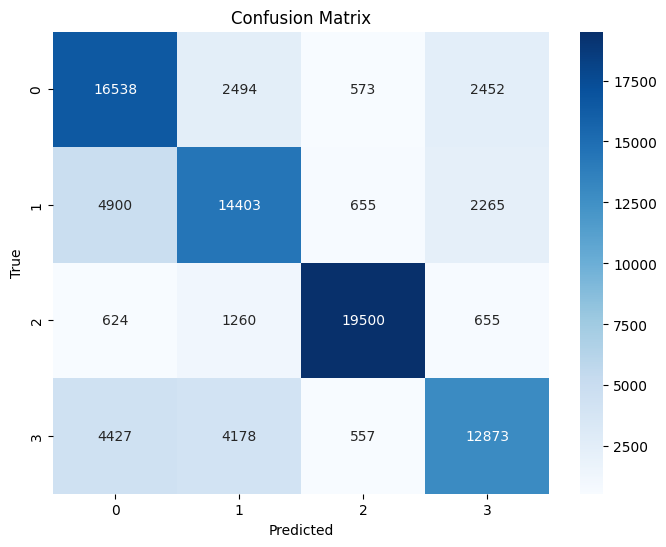

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [ ]:

# Bagging Classifier
bagging_model = BaggingClassifier(random_state=42)
bagging_model.fit(X_train_pca, y_train)
y_pred_bagging = bagging_model.predict(X_test_pca)
accuracy_bagging = accuracy_score(y_test, y_pred_bagging)
print(f"Bagging Accuracy: {accuracy_bagging}")
print(classification_report(y_test, y_pred_bagging))

# AdaBoost Classifier
adaboost_model = AdaBoostClassifier(random_state=42)
adaboost_model.fit(X_train_pca, y_train)
y_pred_adaboost = adaboost_model.predict(X_test_pca)
accuracy_adaboost = accuracy_score(y_test, y_pred_adaboost)
print(f"AdaBoost Accuracy: {accuracy_adaboost}")
print(classification_report(y_test, y_pred_adaboost))

# Gradient Boosting Classifier
gb_model = GradientBoostingClassifier(random_state=42)
gb_model.fit(X_train_pca, y_train)
y_pred_gb = gb_model.predict(X_test_pca)
accuracy_gb = accuracy_score(y_test, y_pred_gb)
print(f"Gradient Boosting Accuracy: {accuracy_gb}")
print(classification_report(y_test, y_pred_gb))

Bagging Accuracy: 0.8937003418068226
              precision    recall  f1-score   support

         0.0       0.82      0.91      0.86     22057
         1.0       0.89      0.86      0.88     22223
         2.0       0.96      0.96      0.96     22039
         3.0       0.91      0.85      0.88     22035

    accuracy                           0.89     88354
   macro avg       0.90      0.89      0.89     88354
weighted avg       0.90      0.89      0.89     88354



/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


AdaBoost Accuracy: 0.6884917491002105
              precision    recall  f1-score   support

         0.0       0.56      0.80      0.66     22057
         1.0       0.77      0.49      0.60     22223
         2.0       0.96      0.82      0.89     22039
         3.0       0.59      0.65      0.62     22035

    accuracy                           0.69     88354
   macro avg       0.72      0.69      0.69     88354
weighted avg       0.72      0.69      0.69     88354

Gradient Boosting Accuracy: 0.7621273513366684
              precision    recall  f1-score   support

         0.0       0.64      0.84      0.73     22057
         1.0       0.71      0.72      0.72     22223
         2.0       0.96      0.87      0.91     22039
         3.0       0.81      0.62      0.70     22035

    accuracy                           0.76     88354
   macro avg       0.78      0.76      0.76     88354
weighted avg       0.78      0.76      0.76     88354

